In [6]:
import pandas as pd
import matplotlib
import plotly.express as px

In [7]:
df = pd.read_csv(r"C:\Users\huanh\OneDrive\Escritorio\data_transformed.csv")
df.head()

,status,bed,bath,acre_lot,city,state,zip_code,house_size,prev_sold_date,price
0,1.0,3.0,2.0,0.12,14.0,9.0,601.0,920.0,0.0,105000.0
1,1.0,4.0,2.0,0.08,14.0,9.0,601.0,1527.0,0.0,80000.0
2,1.0,2.0,1.0,0.15,1051.0,9.0,795.0,748.0,0.0,67000.0
3,1.0,4.0,2.0,0.10,1723.0,9.0,731.0,1800.0,0.0,145000.0
4,1.0,6.0,2.0,0.05,1284.0,9.0,680.0,928.4,0.0,65000.0


In [8]:
column_num = ['bed', 'bath', 'acre_lot', 'house_size', 'price']


fig = px.box(df[column_num], labels={'variable': 'Column', 'value': 'Value'}, title='Outlier Before Remove')


fig.update_xaxes(tickvals=[1, 2, 3, 4, 5], ticktext=column_num)


fig.show()

print(f'Total Rows with Outliers: {df.shape[0]}')

Total Rows with Outliers: 110044


In [9]:
Q1 = df[column_num].quantile(0.25)
Q3 = df[column_num].quantile(0.75)
IQR = Q3 - Q1

df = df[~((df[column_num] < (Q1 - 1.5 * IQR)) | (df[column_num] > (Q3 + 1.5 * IQR))).any(axis=1)]
print(IQR)

bed                2.00
bath               1.60
acre_lot           1.01
house_size      1300.85
price         551995.00
dtype: float64


In [10]:
column_num = ['bed', 'bath', 'acre_lot', 'house_size', 'price']


df_selected = df[column_num]

df_selected_melted = df_selected.melt(var_name='Column', value_name='Value')
fig = px.box(df_selected_melted, x='Column', y='Value', title='Outlier After Remove')

fig.update_xaxes(tickvals=[1, 2, 3, 4, 5], ticktext=column_num)

fig.show()

print(f'Total Rows Without Outliers: {df.shape[0]}')

Total Rows Without Outliers: 80993


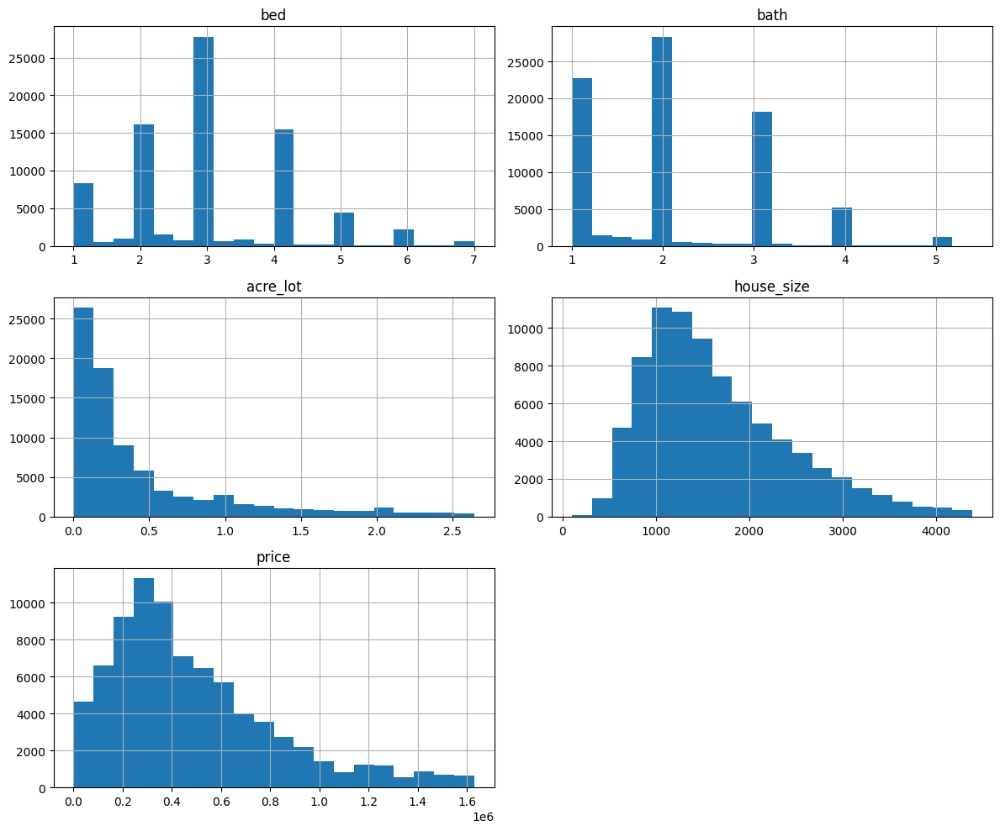

In [11]:
import matplotlib.pyplot as plt

# Plot histograms for numerical columns
df[['bed', 'bath', 'acre_lot', 'house_size', 'price']].hist(bins=20, figsize=(12, 10))
plt.tight_layout()
plt.show()


C:\Users\huanh\AppData\Local\Temp\ipykernel_8936\3131877186.py:8: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.




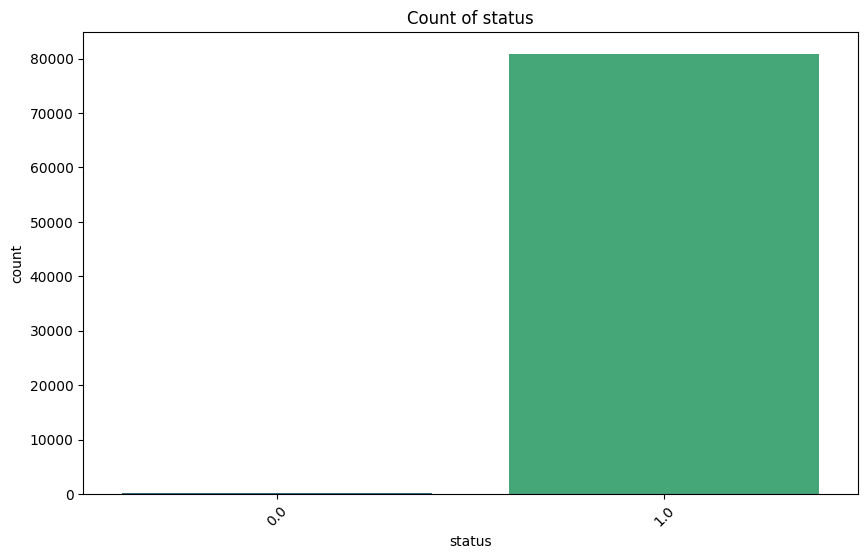

C:\Users\huanh\AppData\Local\Temp\ipykernel_8936\3131877186.py:8: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.




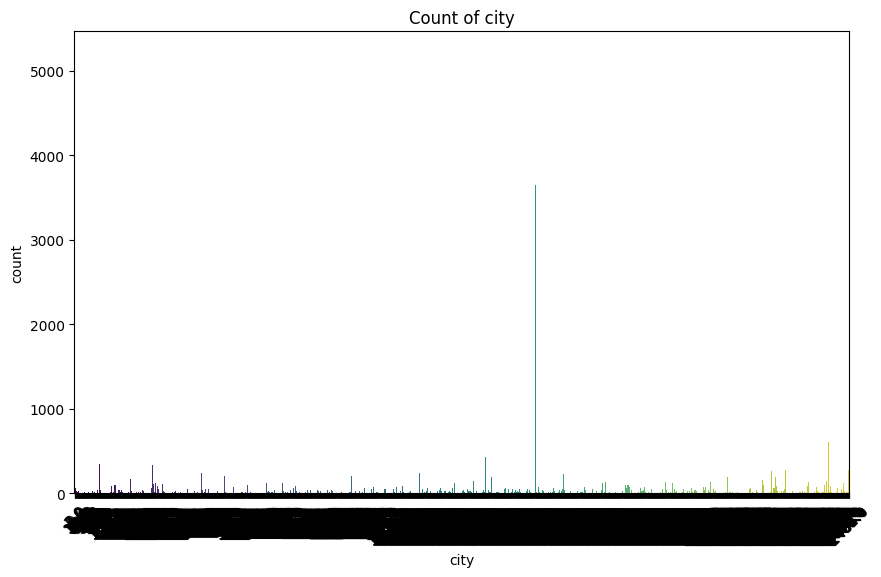

C:\Users\huanh\AppData\Local\Temp\ipykernel_8936\3131877186.py:8: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.




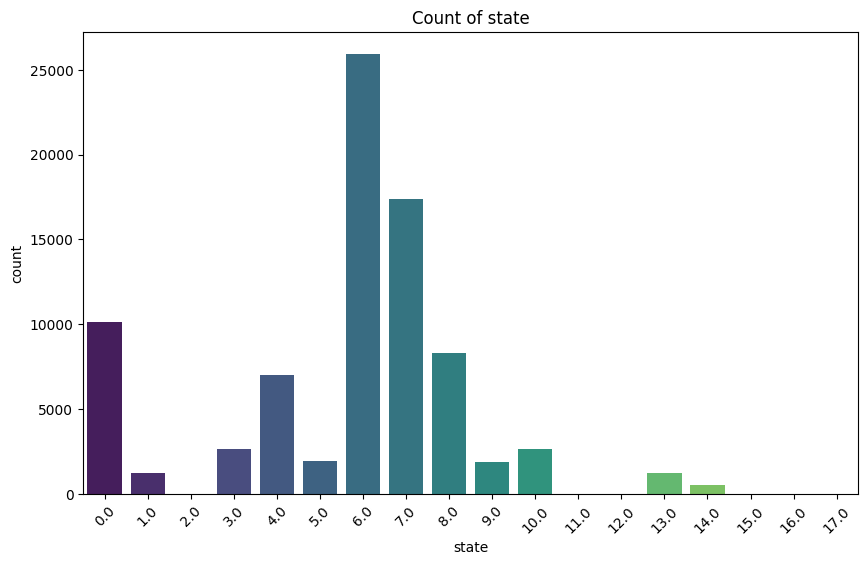

In [12]:
import seaborn as sns
import matplotlib.pyplot as plt

# Plot bar charts for categorical columns
categorical_columns = ['status', 'city', 'state']
for column in categorical_columns:
    plt.figure(figsize=(10, 6))
    sns.countplot(data=df, x=column, palette='viridis')
    plt.title(f'Count of {column}')
    plt.xticks(rotation=45)
    plt.show()

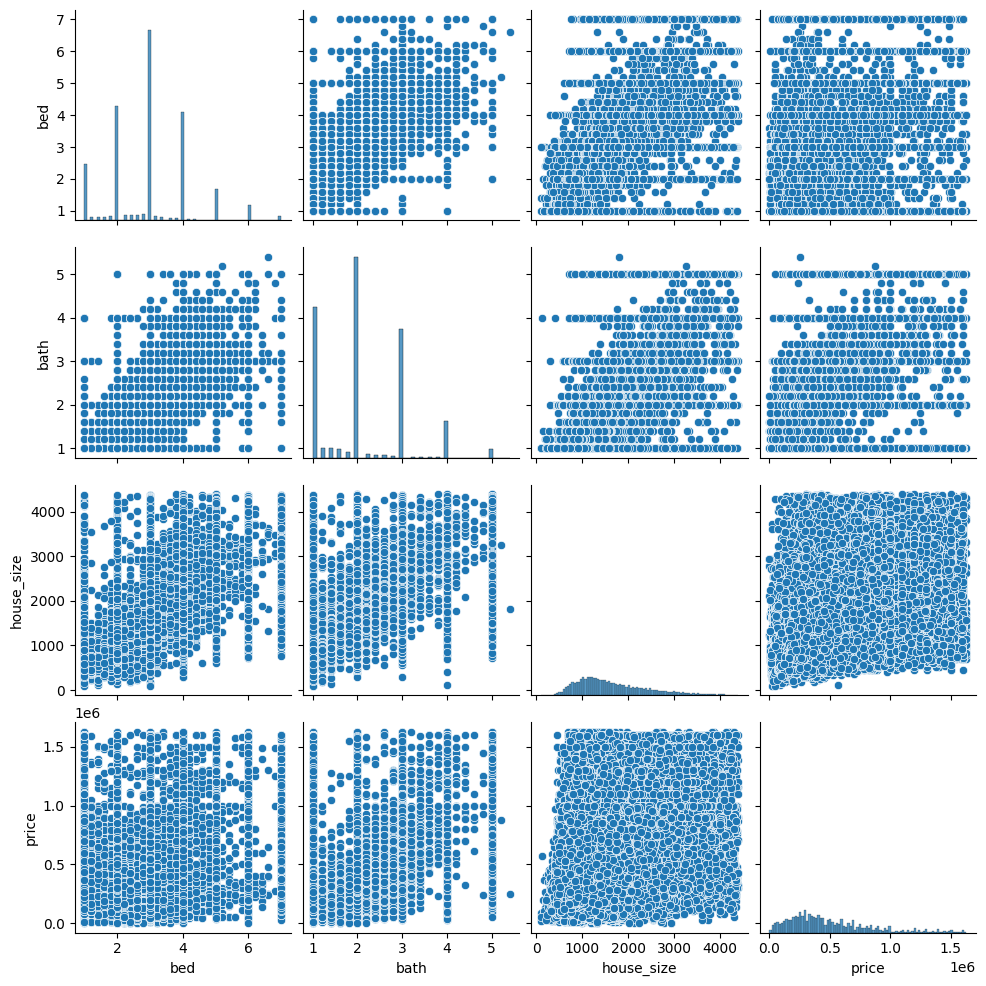

In [13]:
import seaborn as sns
import matplotlib.pyplot as plt

# Scatter plot for relationships
sns.pairplot(df[['bed', 'bath', 'house_size', 'price']])
plt.show()


C:\Users\huanh\AppData\Local\Temp\ipykernel_8936\2733211690.py:8: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.




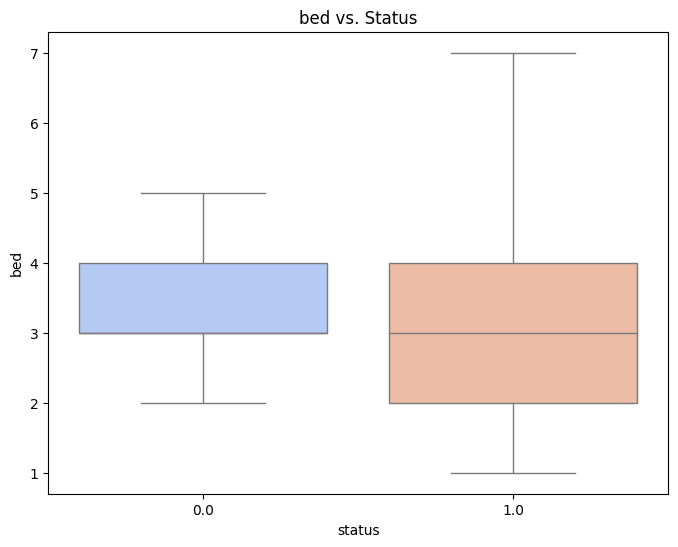

C:\Users\huanh\AppData\Local\Temp\ipykernel_8936\2733211690.py:8: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.




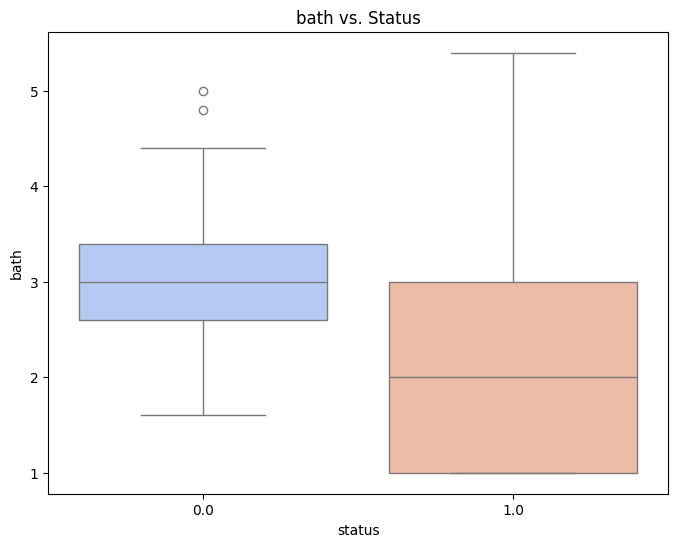

C:\Users\huanh\AppData\Local\Temp\ipykernel_8936\2733211690.py:8: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.




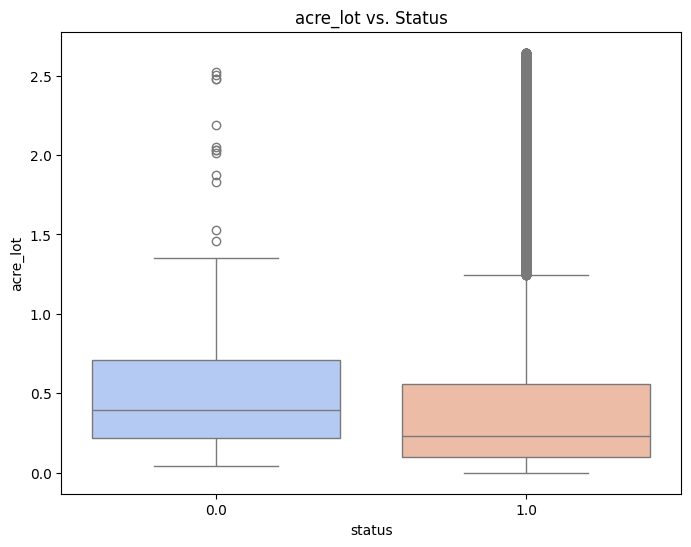

C:\Users\huanh\AppData\Local\Temp\ipykernel_8936\2733211690.py:8: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.




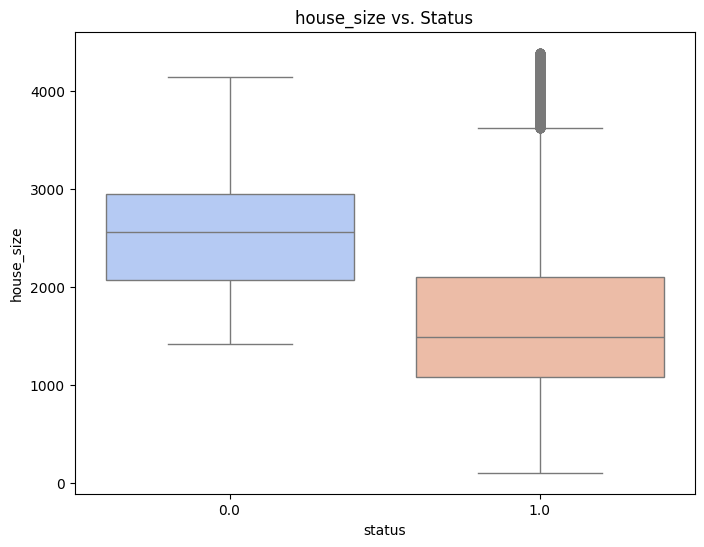

C:\Users\huanh\AppData\Local\Temp\ipykernel_8936\2733211690.py:8: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.




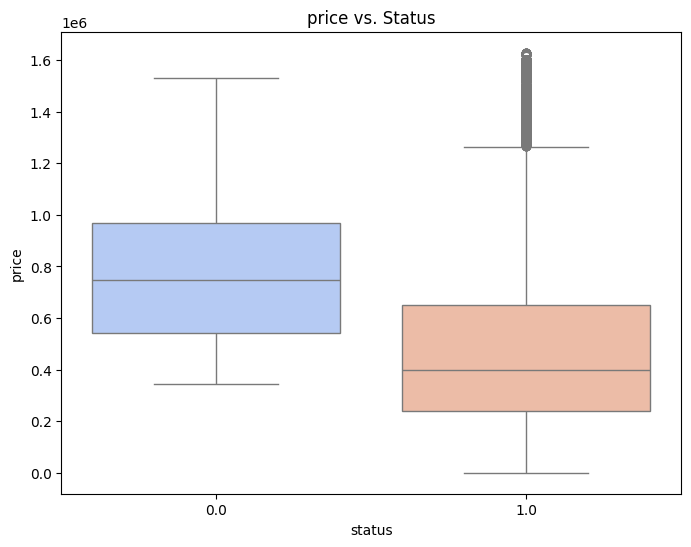

In [14]:
import seaborn as sns
import matplotlib.pyplot as plt

# Box plot for numerical columns
numerical_columns = ['bed', 'bath', 'acre_lot', 'house_size', 'price']
for column in numerical_columns:
    plt.figure(figsize=(8, 6))
    sns.boxplot(x='status', y=column, data=df, palette='coolwarm')
    plt.title(f'{column} vs. Status')
    plt.show()


In [16]:
from sklearn.model_selection import train_test_split

df_train_temp, df_temp = train_test_split(df, test_size=0.3, random_state=42)

df_validation, df_test = train_test_split(df_temp, test_size=0.5, random_state=42)

In [17]:
from sklearn.ensemble import GradientBoostingRegressor
from sklearn.metrics import mean_squared_error

In [20]:
X_train = df_train_temp.drop(columns=['status', 'bed', 'bath', 'acre_lot', 'city', 'state', 'zip_code', 'house_size'])  # Replace 'target_column' with the actual name of your target variable
y_train = df_train_temp['price']

# Extract features and target variable for validation set
X_validation = df_validation.drop(columns=['status', 'bed', 'bath', 'acre_lot', 'city', 'state', 'zip_code', 'house_size'])
y_validation = df_validation['price']

In [21]:
# Initialize and train the Gradient Boosting Regressor
gbr = GradientBoostingRegressor(n_estimators=100, learning_rate=0.1, random_state=42)
gbr.fit(X_train, y_train)

GradientBoostingRegressor(random_state=42)

In [22]:
# Make predictions on the validation set
validation_predictions = gbr.predict(X_validation)

# Evaluate the model using Mean Squared Error (MSE) on the validation set
validation_mse = mean_squared_error(y_validation, validation_predictions)
print("Validation Mean Squared Error:", validation_mse)

Validation Mean Squared Error: 4526668.96655506


In [23]:
# Once you're satisfied with the validation performance, you can evaluate the model on the test set
X_test = df_test.drop(columns=['status', 'bed', 'bath', 'acre_lot', 'city', 'state', 'zip_code', 'house_size'])
y_test = df_test['price']

# Make predictions on the test set
test_predictions = gbr.predict(X_test)

# Evaluate the model using Mean Squared Error (MSE) on the test set
test_mse = mean_squared_error(y_test, test_predictions)
print("Test Mean Squared Error:", test_mse)

Test Mean Squared Error: 4283635.338421576


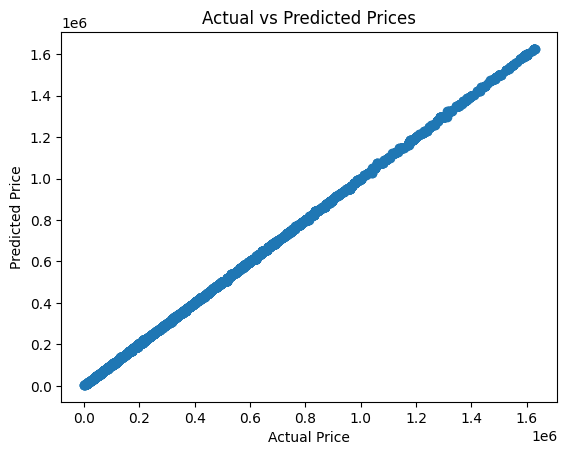

In [25]:
plt.scatter(y_test, test_predictions)
plt.xlabel('Actual Price')
plt.ylabel('Predicted Price')
plt.title('Actual vs Predicted Prices')
plt.show()